<a href="https://colab.research.google.com/github/NataSamo/Python-ML/blob/main/NNTestWithMyData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle


!kaggle datasets download -d alxmamaev/flowers-recognition


!unzip flowers-recognition.zip -d flowers_recognition


Dataset URL: https://www.kaggle.com/datasets/alxmamaev/flowers-recognition
License(s): unknown
 96% 216M/225M [00:02<00:00, 70.7MB/s]
100% 225M/225M [00:02<00:00, 87.5MB/s]
Archive:  flowers-recognition.zip
  inflating: flowers_recognition/flowers/daisy/100080576_f52e8ee070_n.jpg  
  inflating: flowers_recognition/flowers/daisy/10140303196_b88d3d6cec.jpg  
  inflating: flowers_recognition/flowers/daisy/10172379554_b296050f82_n.jpg  
  inflating: flowers_recognition/flowers/daisy/10172567486_2748826a8b.jpg  
  inflating: flowers_recognition/flowers/daisy/10172636503_21bededa75_n.jpg  
  inflating: flowers_recognition/flowers/daisy/102841525_bd6628ae3c.jpg  
  inflating: flowers_recognition/flowers/daisy/10300722094_28fa978807_n.jpg  
  inflating: flowers_recognition/flowers/daisy/1031799732_e7f4008c03.jpg  
  inflating: flowers_recognition/flowers/daisy/10391248763_1d16681106_n.jpg  
  inflating: flowers_recognition/flowers/daisy/10437754174_22ec990b77_m.jpg  
  inflating: flowers_recog

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, classification_report
from tensorflow.keras import models, layers
from tensorflow.keras.applications import VGG16
from PIL import Image

data_dir_train = 'flowers_recognition/flowers'
data_dir_test = '/content/drive/MyDrive/my_flowers_test'
categories = os.listdir(data_dir_train)
print(f"Категории цветов: {categories}")


def load_images_from_folder(folder, categories, target_size=(128, 128)):
    images = []
    labels = []
    for label, category in enumerate(categories):
        category_path = os.path.join(folder, category)
        if os.path.isdir(category_path):
            for filename in os.listdir(category_path):
                img_path = os.path.join(category_path, filename)
                try:
                    img = Image.open(img_path).convert("RGB")
                    img_resized = img.resize(target_size)
                    images.append(np.array(img_resized))
                    labels.append(label)
                except Exception as e:
                    print(f"Ошибка при обработке изображения {img_path}: {e}")
    return np.array(images), np.array(labels)


X_train, y_train = load_images_from_folder(data_dir_train, categories)
X_test, y_test = load_images_from_folder(data_dir_test, categories)


X_train = X_train / 255.0
X_test = X_test / 255.0

print(f"Размер тренировочного набора: {X_train.shape}, Размер тестового набора: {X_test.shape}")

Категории цветов: ['rose', 'sunflower', 'tulip', 'dandelion', 'daisy']
Размер тренировочного набора: (4317, 128, 128, 3), Размер тестового набора: (50, 128, 128, 3)


In [ ]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
file_id = '1xfeULKGXOdbU4sm05PWVmcnnrYouKTAy'
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('modelPerceptron.h5')

# Загрузка модели с файла
from keras.models import load_model
model = load_model('modelPerceptron.h5')

In [ ]:
y_pred_perceptron = np.argmax(model.predict(X_test), axis=1)
print("Отчет по классификации персептрона:")
print(classification_report(y_test, y_pred_perceptron))


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Отчет по классификации персептрона:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        10
           1       0.14      0.30      0.19        10
           2       0.50      0.10      0.17        10
           3       0.00      0.00      0.00        10
           4       0.18      0.30      0.22        10

    accuracy                           0.14        50
   macro avg       0.16      0.14      0.12        50
weighted avg       0.16      0.14      0.12        50



In [ ]:
def display_images(indices, title, predictions, true_labels):
    plt.figure(figsize=(10, 10))
    plt.suptitle(title, fontsize=16)
    for i, idx in enumerate(indices[:9]):
        plt.subplot(3, 3, i + 1)
        plt.imshow(X_test[idx])
        plt.title(f"Pred: {categories[predictions[idx]]}\nTrue: {categories[true_labels[idx]]}")
        plt.axis('off')
    plt.show()



Правильные предсказания:


<Figure size 1000x1000 with 0 Axes>

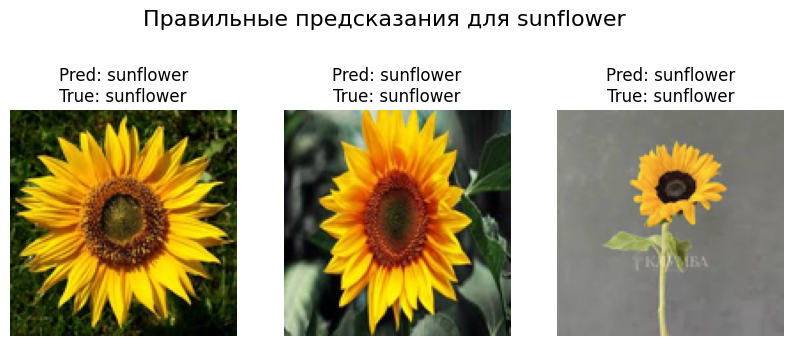

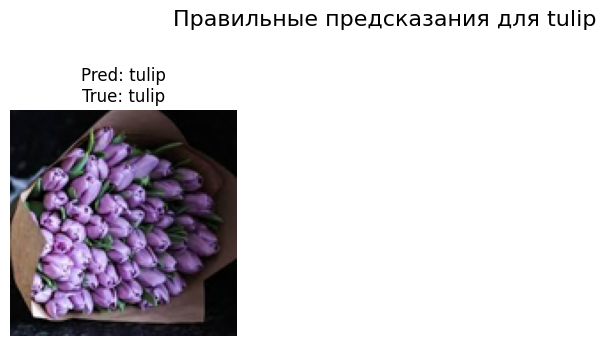

<Figure size 1000x1000 with 0 Axes>

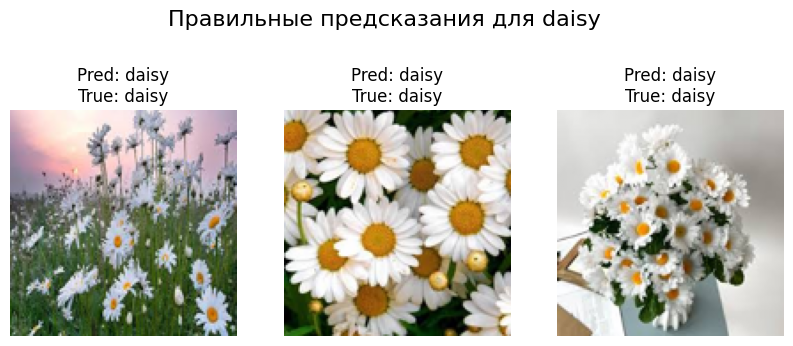

Неправильные предсказания:


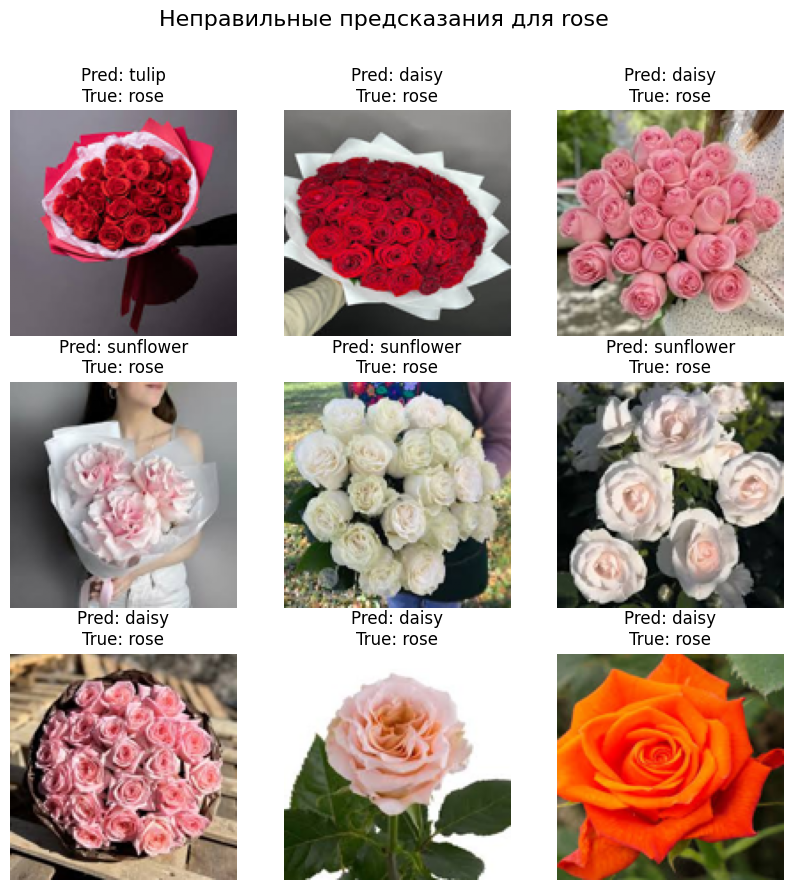

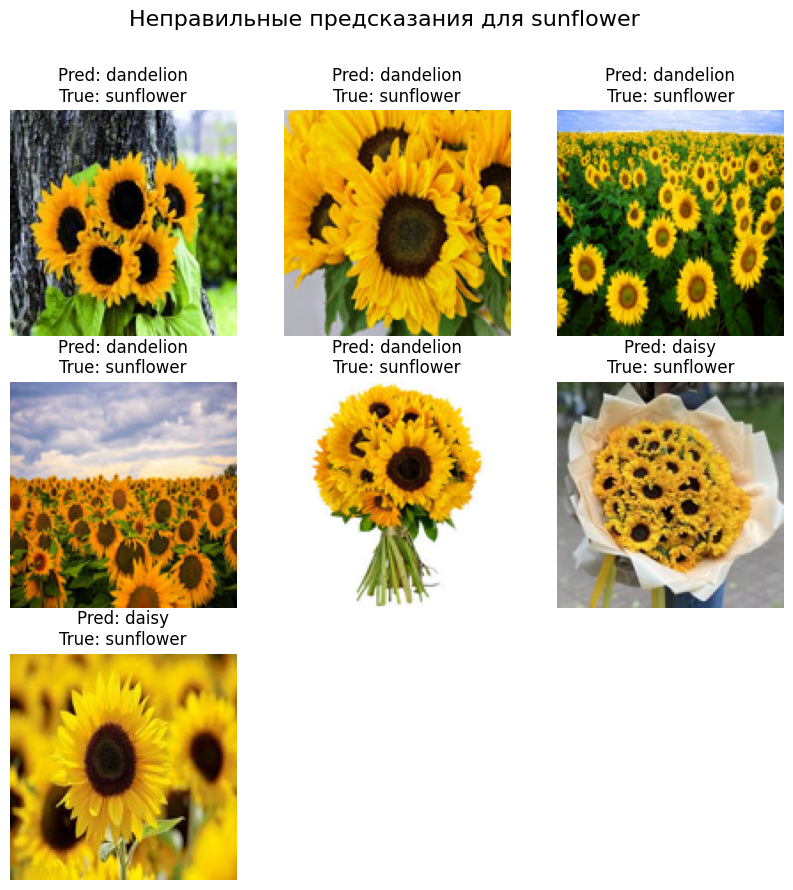

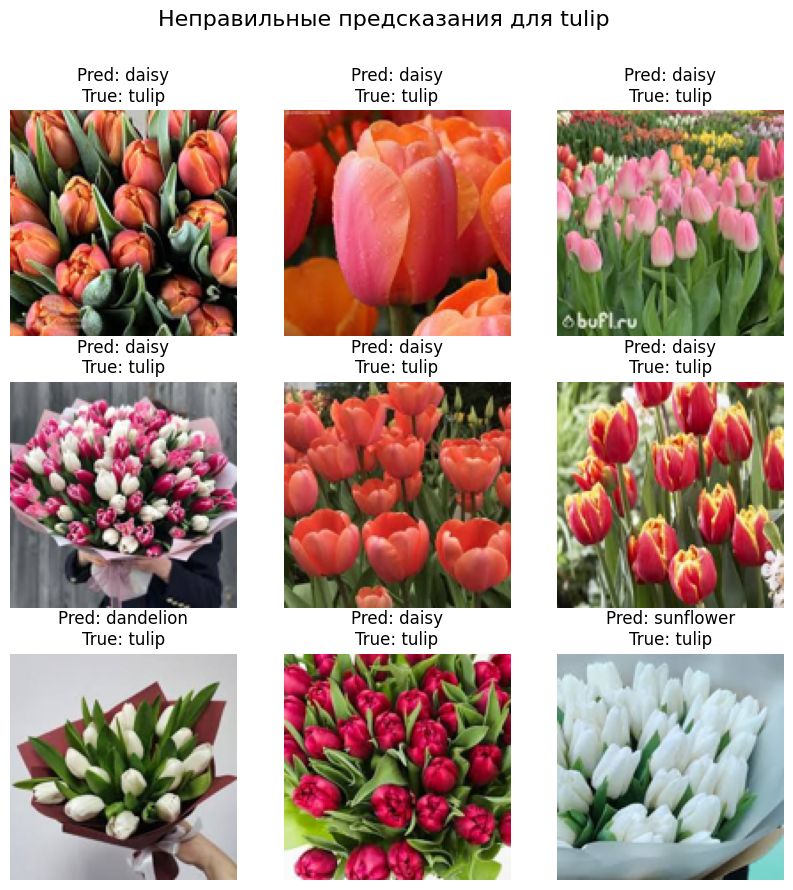

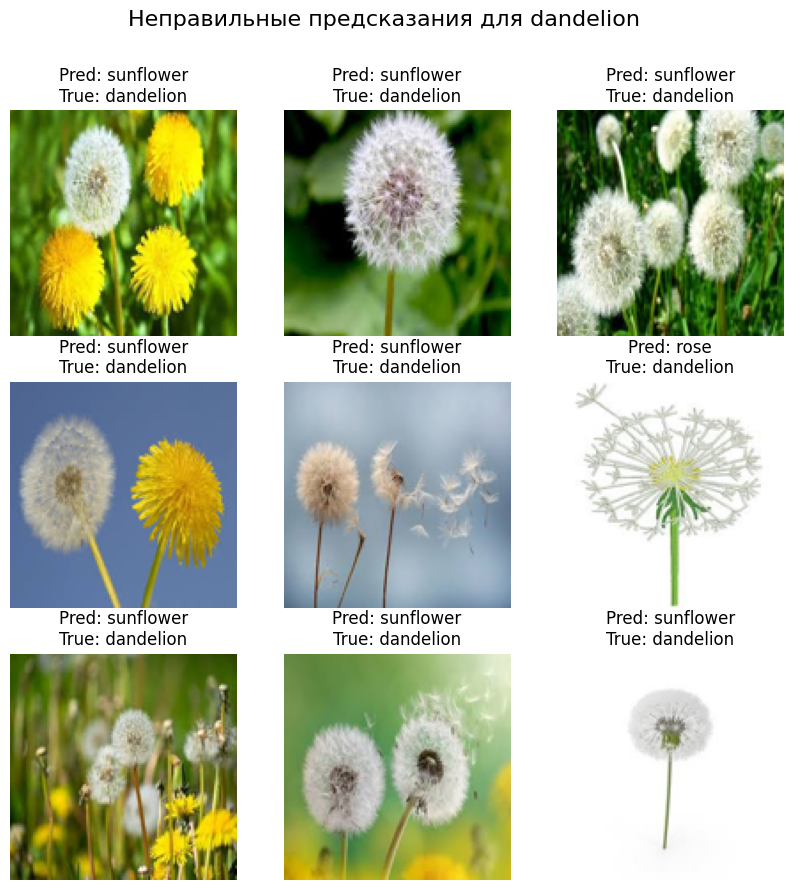

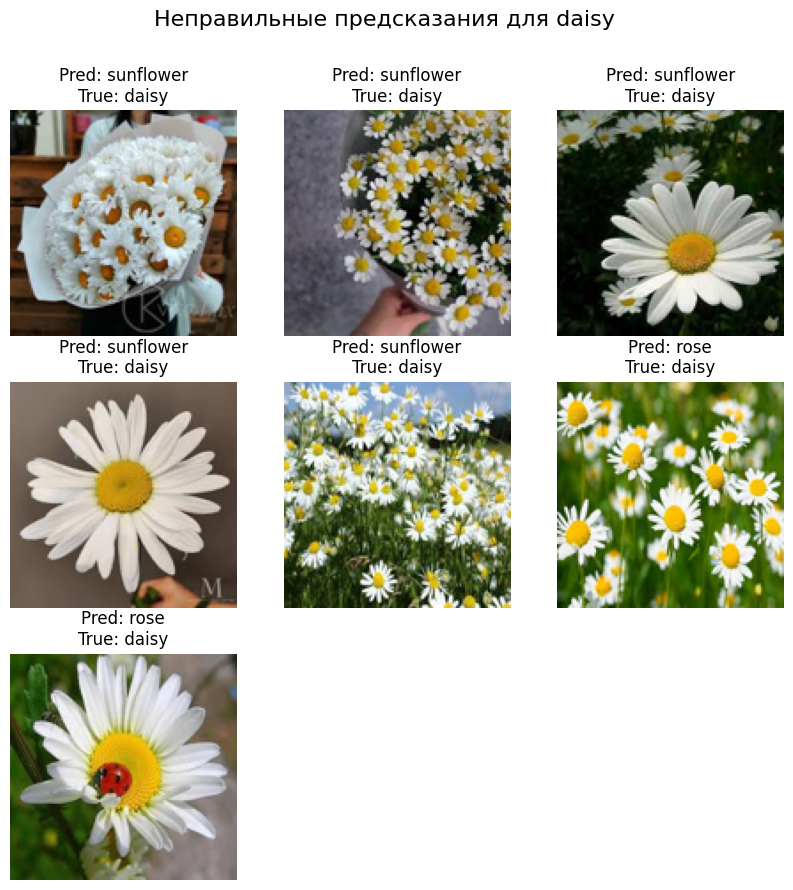

In [ ]:



correct_predictions = np.where(y_pred_perceptron == y_test)[0]
incorrect_predictions = np.where(y_pred_perceptron != y_test)[0]


print("Правильные предсказания:")
for label in np.unique(y_test):
    correct_label_indices = correct_predictions[y_test[correct_predictions] == label]
    display_images(correct_label_indices, f"Правильные предсказания для {categories[label]}", y_pred_perceptron, y_test)


print("Неправильные предсказания:")
for label in np.unique(y_test):
    incorrect_label_indices = incorrect_predictions[y_test[incorrect_predictions] == label]
    display_images(incorrect_label_indices, f"Неправильные предсказания для {categories[label]}", y_pred_perceptron, y_test)

In [ ]:
y_pred_perceptron

array([2, 4, 4, 1, 1, 1, 4, 4, 4, 3, 1, 3, 3, 3, 3, 3, 4, 1, 1, 4, 4, 2,
       4, 4, 4, 4, 4, 3, 4, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 4, 4,
       1, 1, 4, 1, 0, 0])

In [ ]:
y_test

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4])

In [ ]:
file_id = '1wfkS6x_ITE0N9O4lIEHWUJ9QsFKS3jO6'
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('modelPerceptronDiff.h5')


model_perceptron_dif = load_model('modelPerceptronDiff.h5')

In [ ]:
y_pred_perceptron_dif = np.argmax(model_perceptron_dif.predict(X_test), axis=1)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Правильные предсказания:


<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

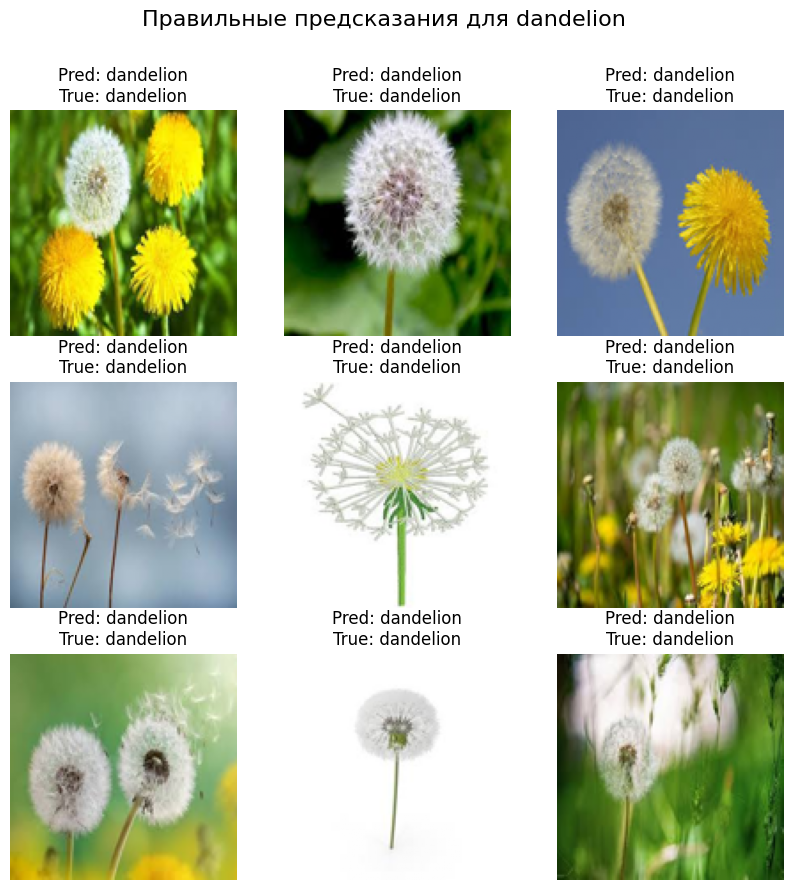

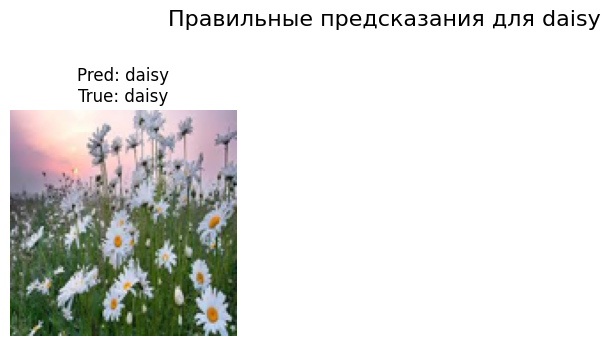

Неправильные предсказания:


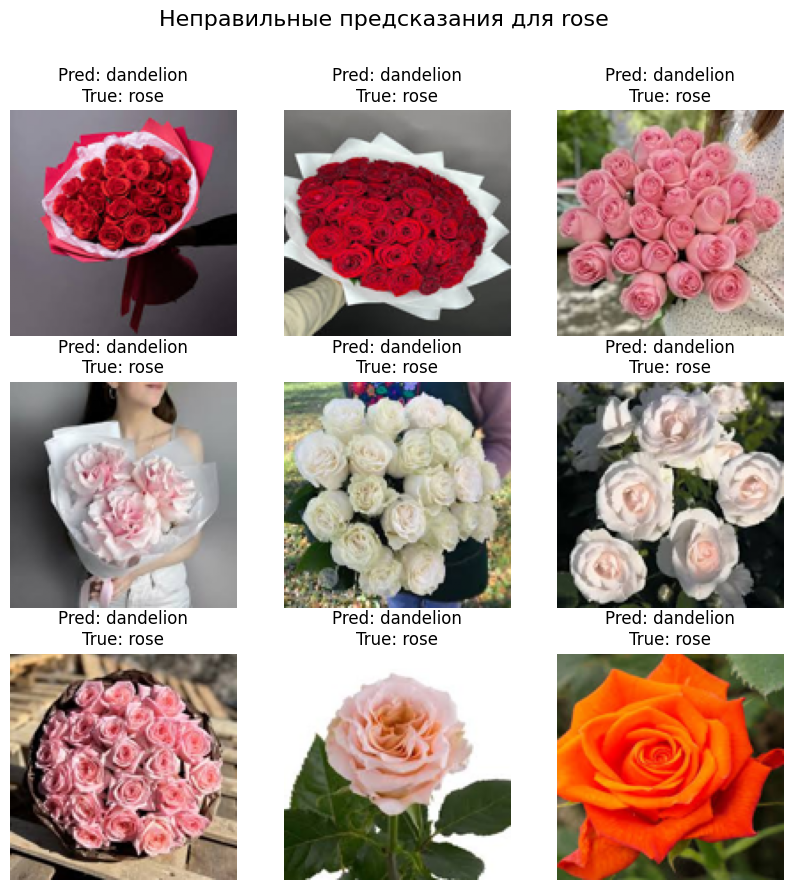

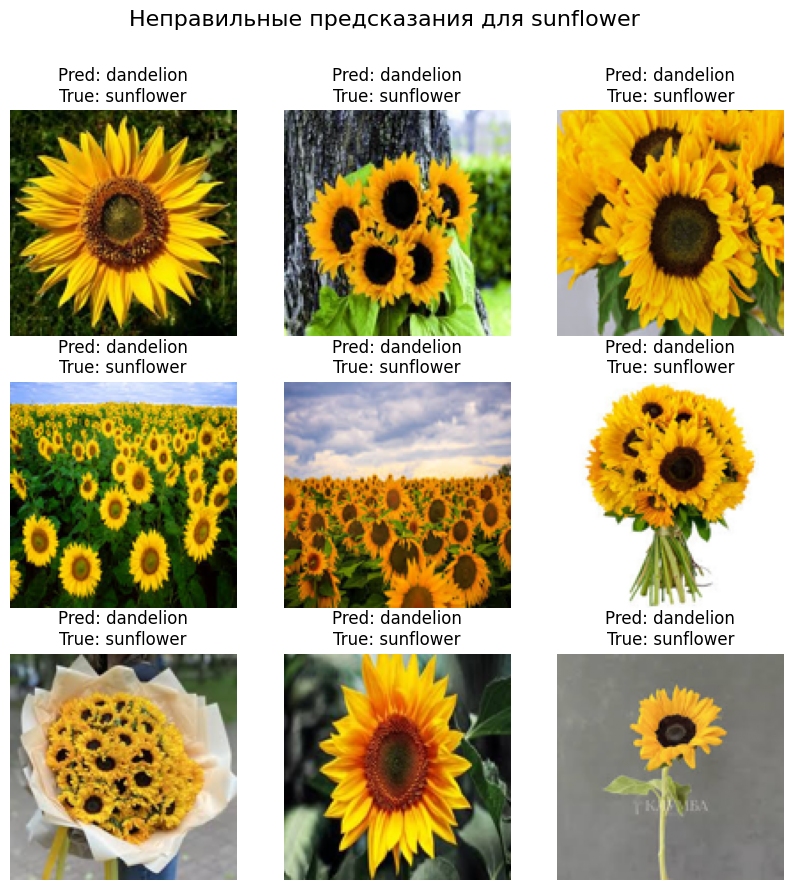

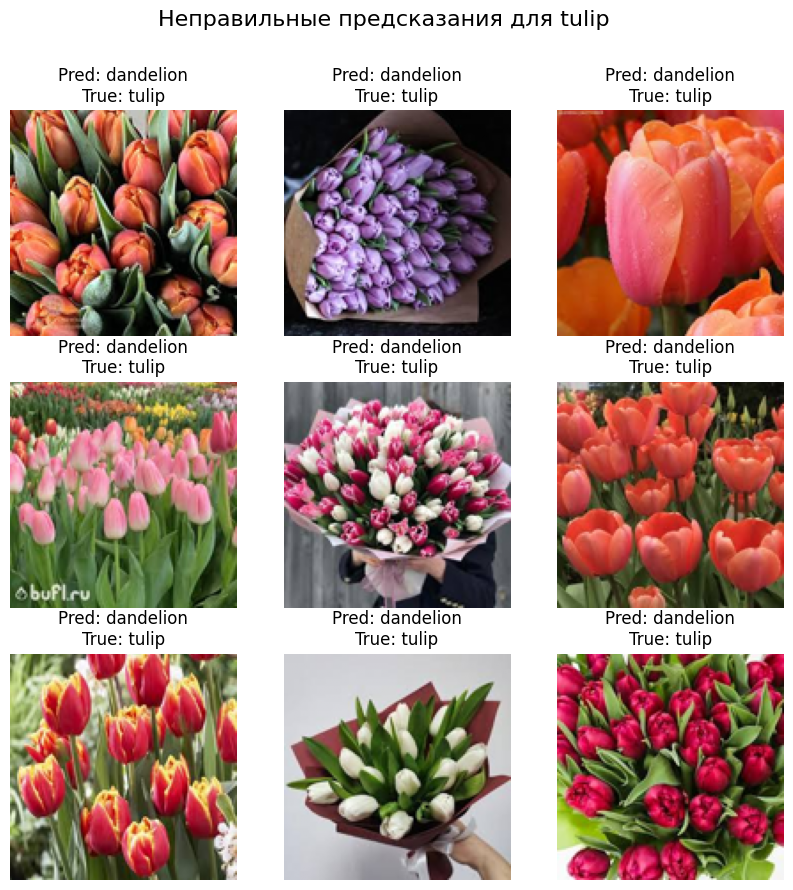

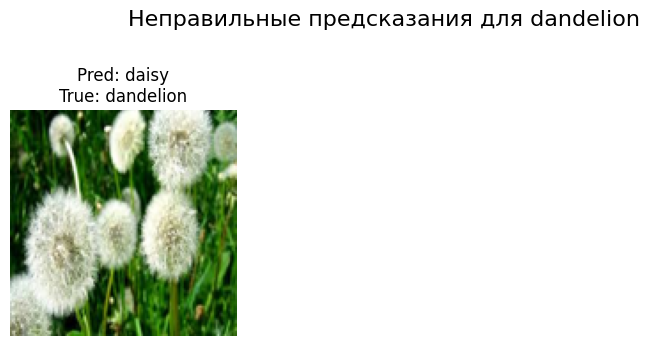

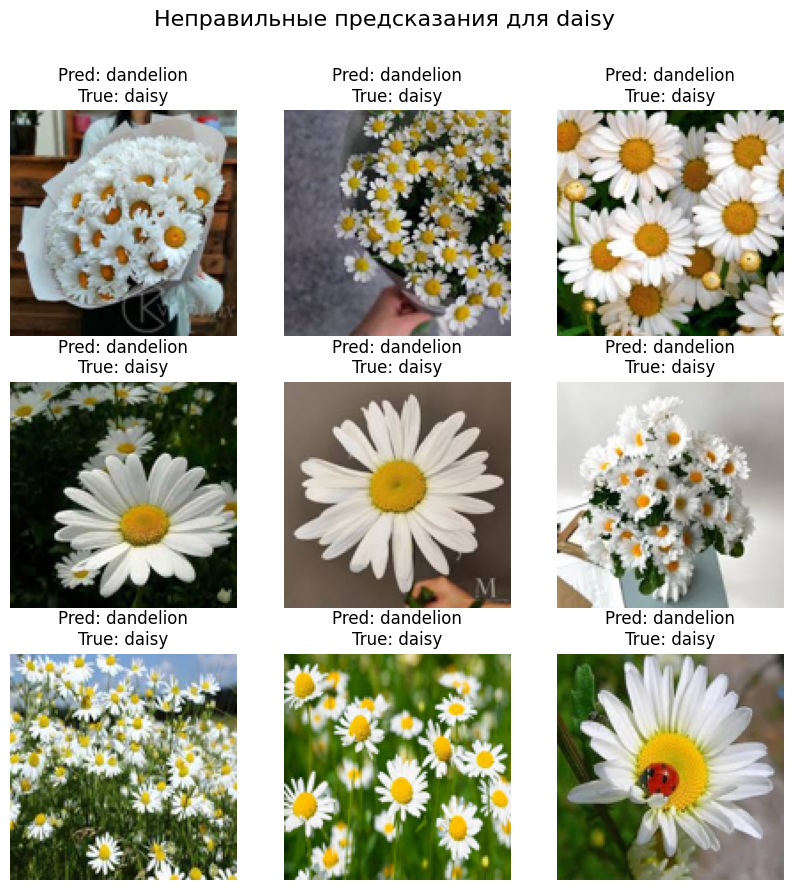

In [ ]:



correct_predictions = np.where(y_pred_perceptron_dif == y_test)[0]
incorrect_predictions = np.where(y_pred_perceptron_dif != y_test)[0]


print("Правильные предсказания:")
for label in np.unique(y_test):
    correct_label_indices = correct_predictions[y_test[correct_predictions] == label]
    display_images(correct_label_indices, f"Правильные предсказания для {categories[label]}", y_pred_perceptron_dif, y_test)


print("Неправильные предсказания:")
for label in np.unique(y_test):
    incorrect_label_indices = incorrect_predictions[y_test[incorrect_predictions] == label]
    display_images(incorrect_label_indices, f"Неправильные предсказания для {categories[label]}", y_pred_perceptron_dif, y_test)

In [ ]:
y_pred_perceptron_dif

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3,
       3, 3, 3, 3, 3, 3])

In [ ]:
file_id = '1zHTr-fO829zwVeAkkAoAWuiiYhAchdmj'
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('modelCNN.h5')


model_cnn = load_model('modelCNN.h5')

In [ ]:
y_pred_cnn = np.argmax(model_cnn.predict(X_test), axis=1)

1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 343ms/step


Правильные предсказания:


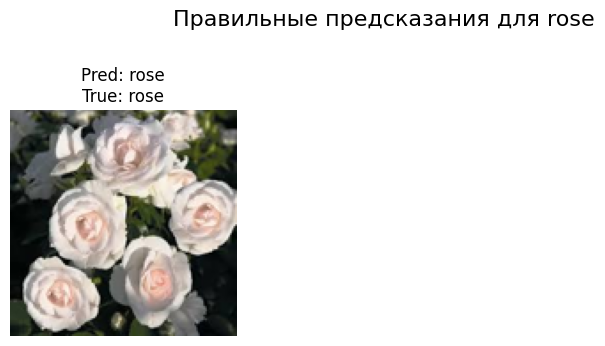

<Figure size 1000x1000 with 0 Axes>

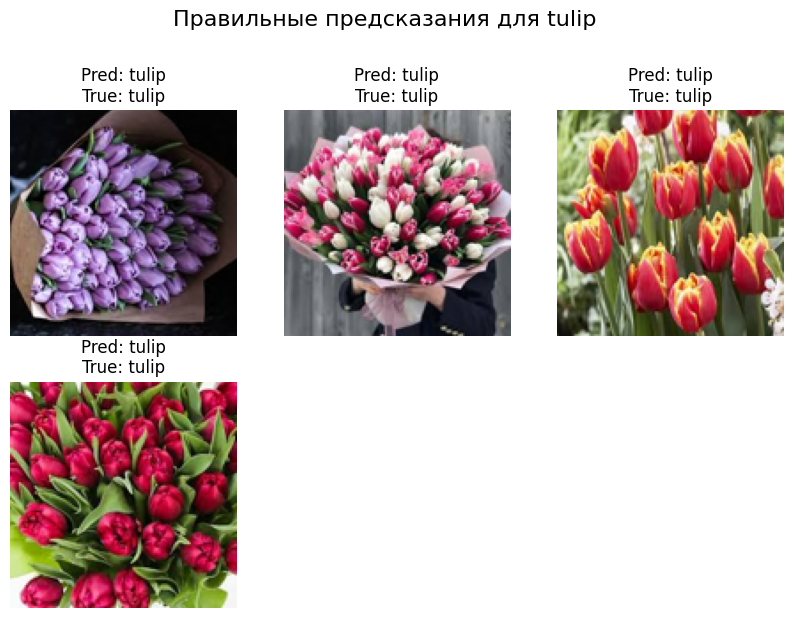

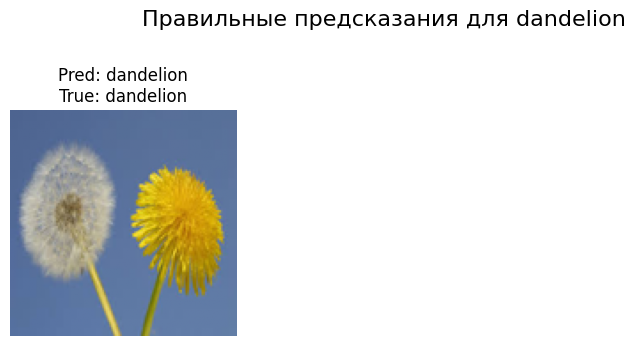

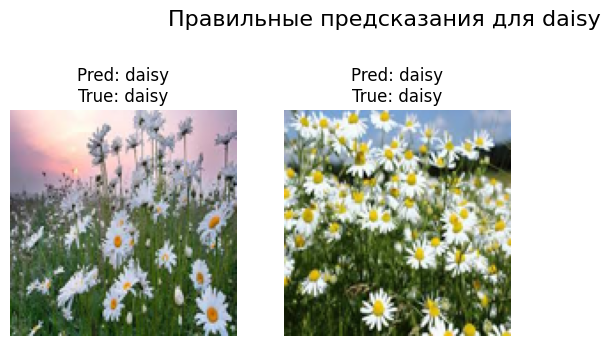

Неправильные предсказания:


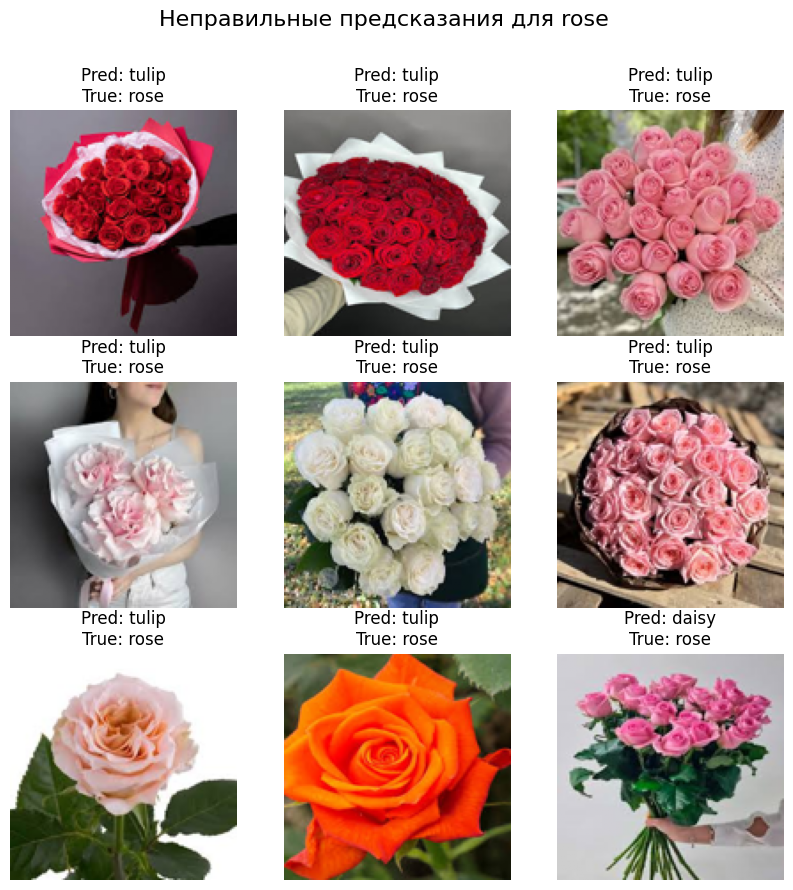

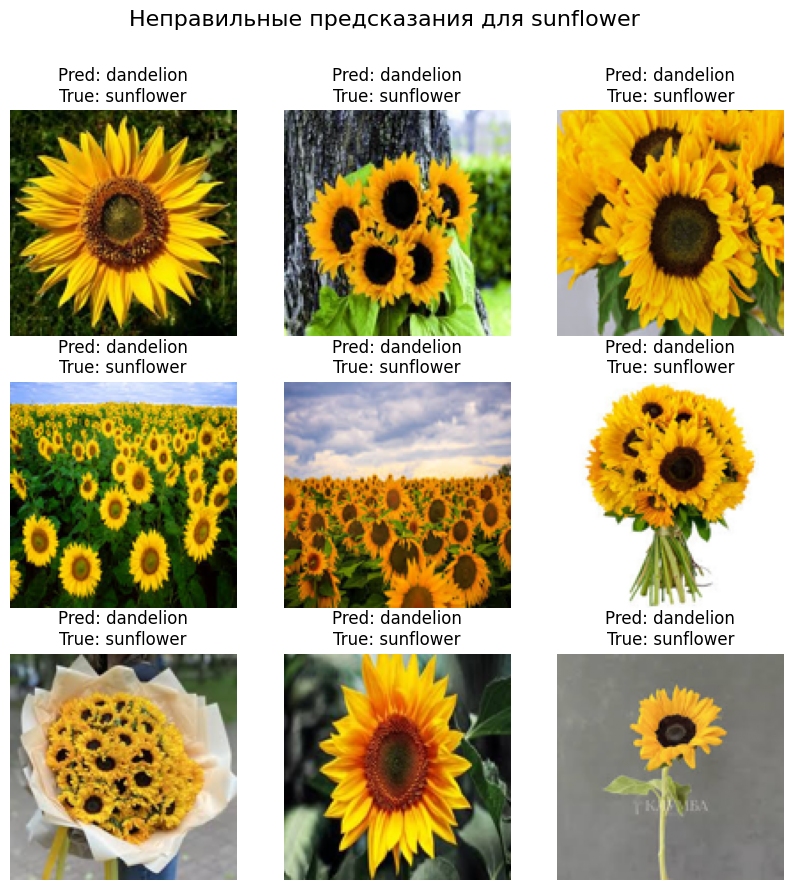

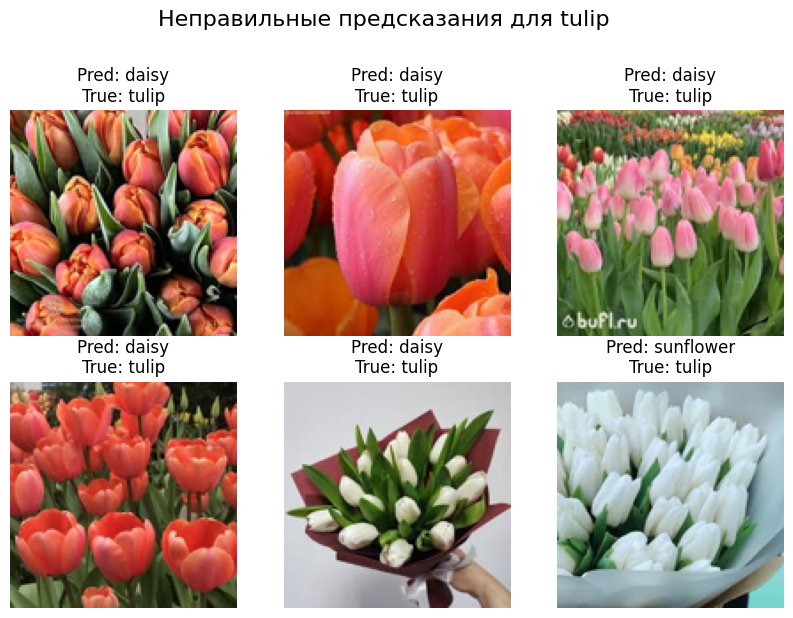

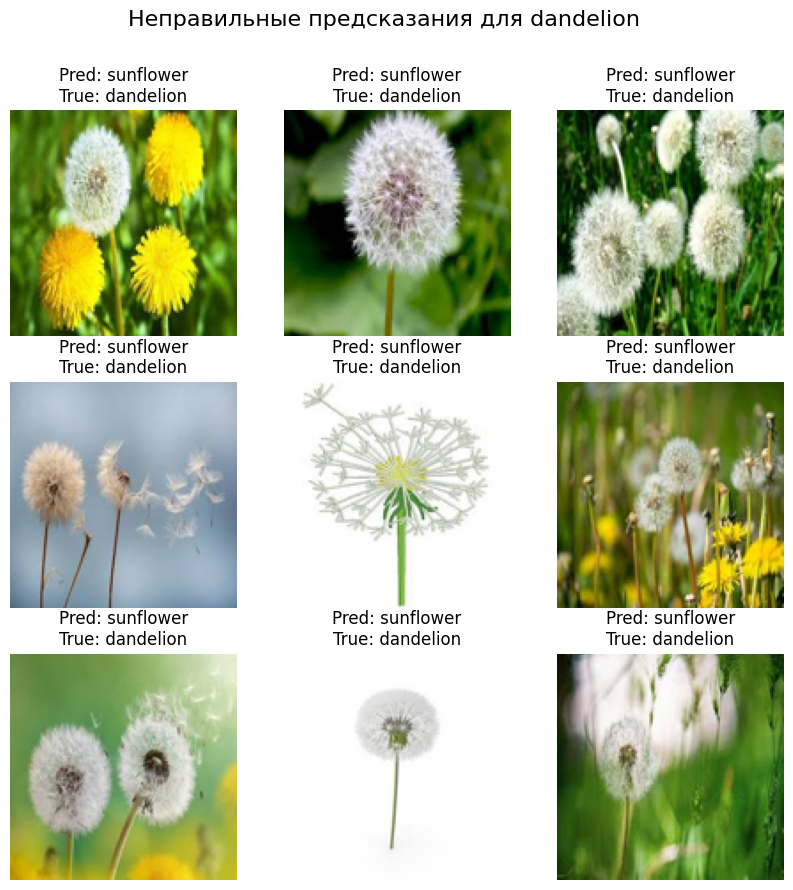

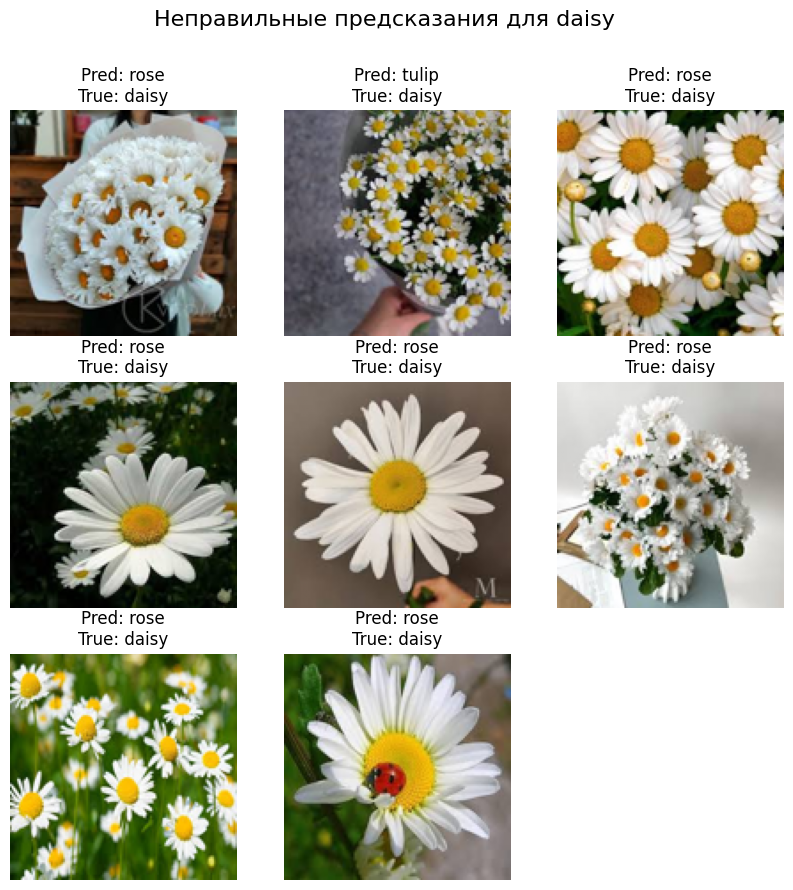

In [ ]:



correct_predictions = np.where(y_pred_cnn == y_test)[0]
incorrect_predictions = np.where(y_pred_cnn != y_test)[0]


print("Правильные предсказания:")
for label in np.unique(y_test):
    correct_label_indices = correct_predictions[y_test[correct_predictions] == label]
    display_images(correct_label_indices, f"Правильные предсказания для {categories[label]}", y_pred_cnn, y_test)


print("Неправильные предсказания:")
for label in np.unique(y_test):
    incorrect_label_indices = incorrect_predictions[y_test[incorrect_predictions] == label]
    display_images(incorrect_label_indices, f"Неправильные предсказания для {categories[label]}", y_pred_cnn, y_test)

In [ ]:
y_pred_cnn

array([2, 2, 2, 2, 2, 0, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2,
       4, 4, 2, 4, 2, 4, 2, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 0, 2, 4, 0,
       0, 0, 0, 4, 0, 0])

In [ ]:
file_id = '134Bk16yberqpjBy5OiiJqgiL1yhBdMYL'
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('modelCNNDif.h5')


model_cnn_dif = load_model('modelCNNDif.h5')

In [ ]:
y_pred_cnn_dif = np.argmax(model_cnn_dif.predict(X_test), axis=1)

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 832ms/step


Правильные предсказания:


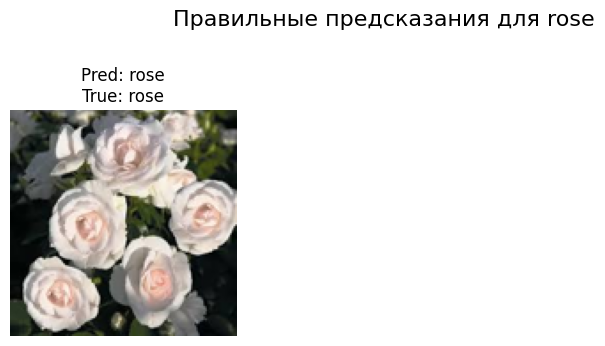

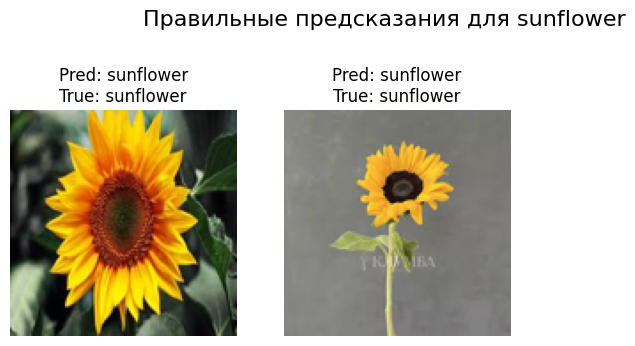

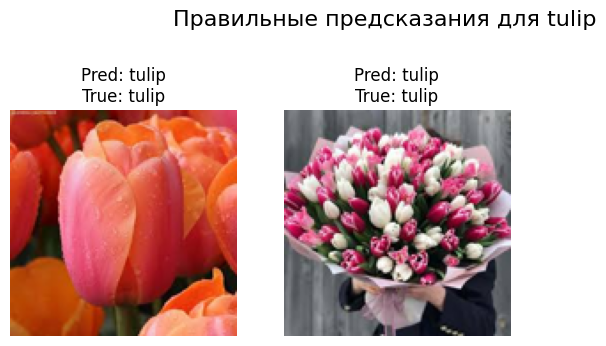

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

Неправильные предсказания:


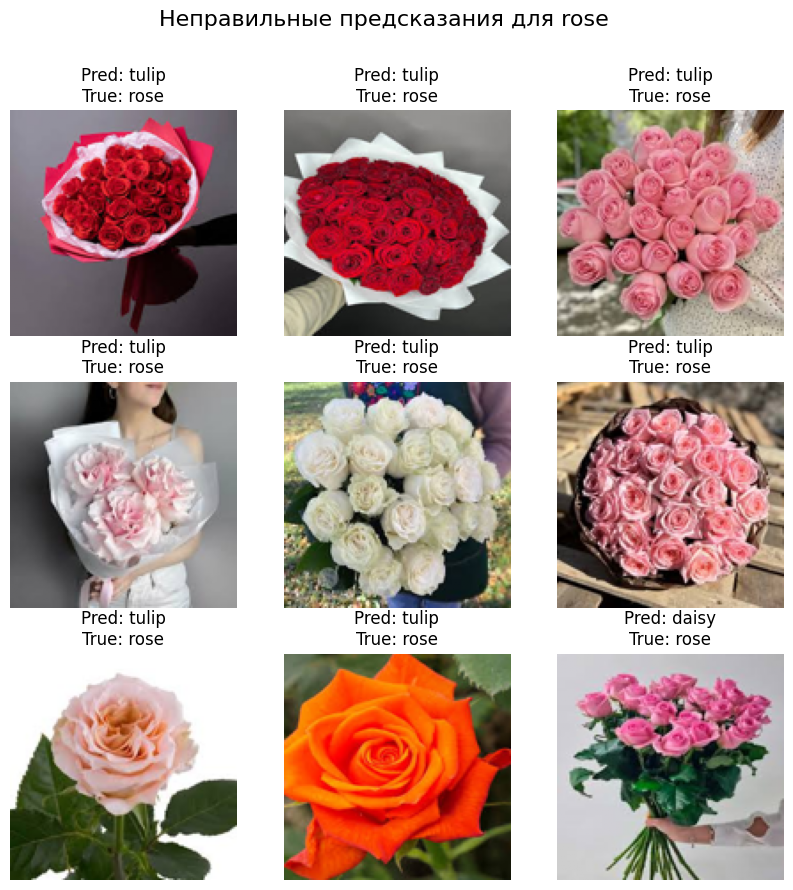

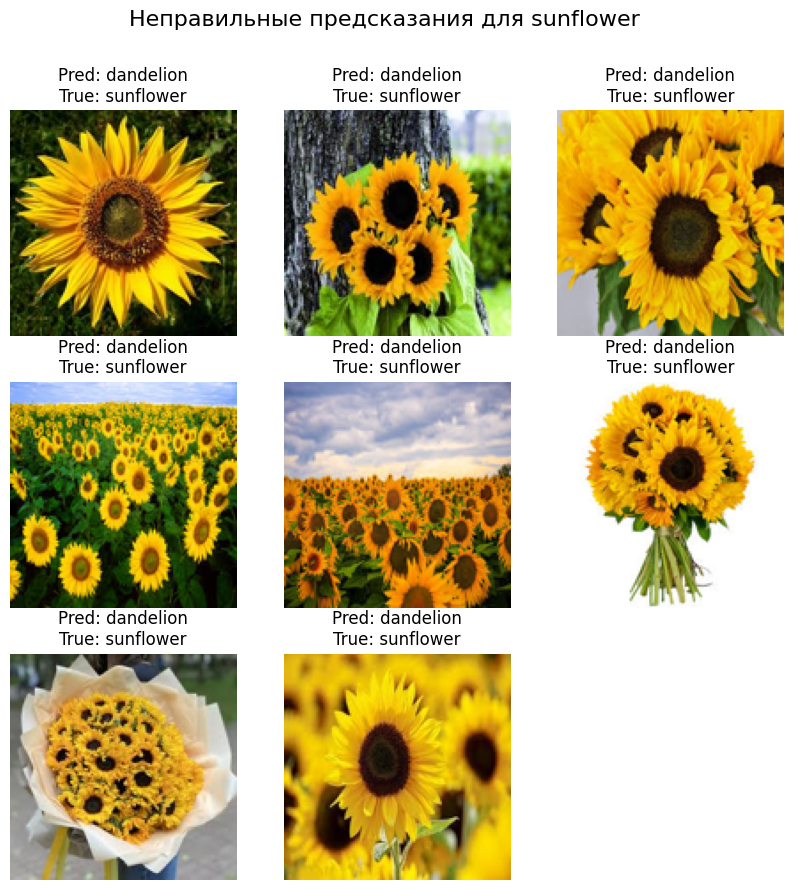

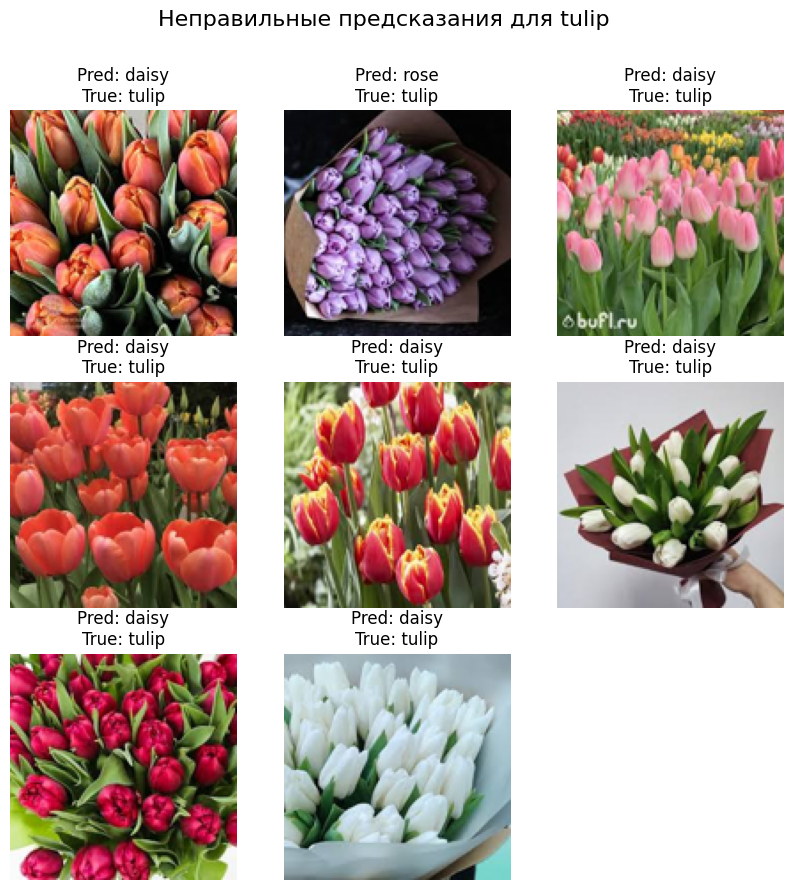

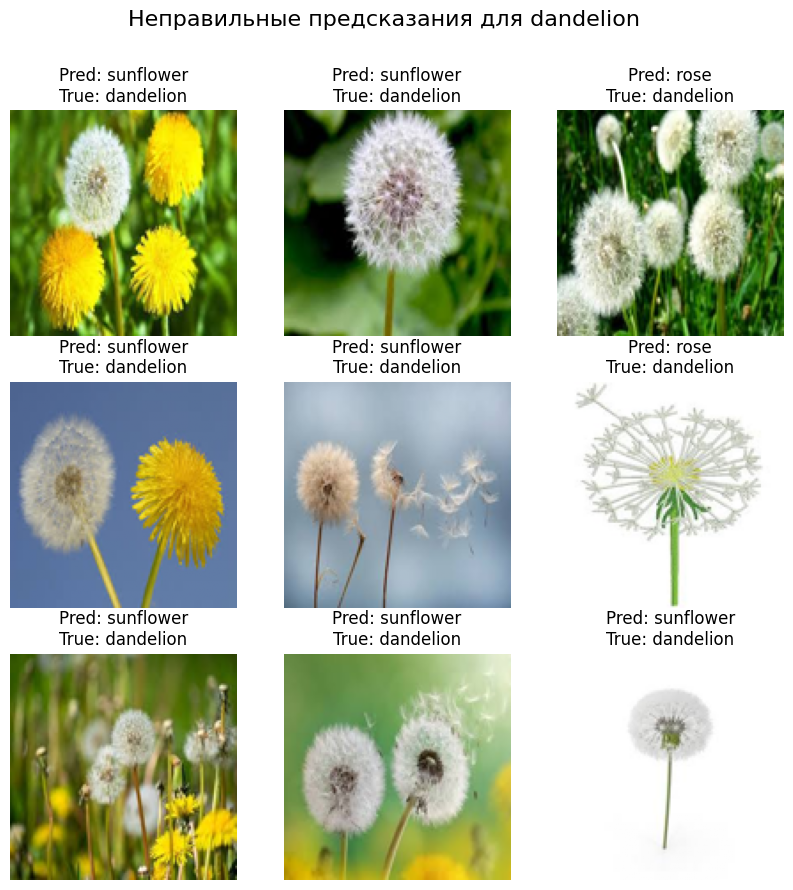

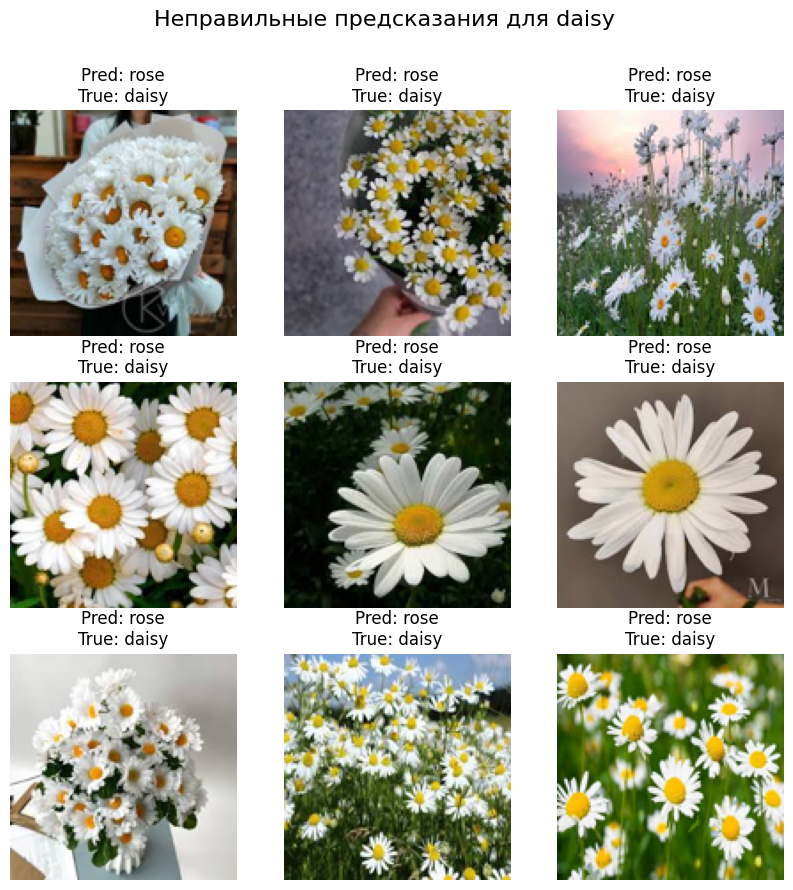

In [ ]:



correct_predictions = np.where(y_pred_cnn_dif == y_test)[0]
incorrect_predictions = np.where(y_pred_cnn_dif != y_test)[0]


print("Правильные предсказания:")
for label in np.unique(y_test):
    correct_label_indices = correct_predictions[y_test[correct_predictions] == label]
    display_images(correct_label_indices, f"Правильные предсказания для {categories[label]}", y_pred_cnn_dif, y_test)


print("Неправильные предсказания:")
for label in np.unique(y_test):
    incorrect_label_indices = incorrect_predictions[y_test[incorrect_predictions] == label]
    display_images(incorrect_label_indices, f"Неправильные предсказания для {categories[label]}", y_pred_cnn_dif, y_test)

In [ ]:
y_pred_cnn_dif

array([2, 2, 2, 2, 2, 0, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 4, 0,
       2, 4, 2, 4, 4, 4, 4, 4, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0])

In [ ]:
file_id = '1UywyNWb3O2DxKSWj3Ro8OHOi3WmndYh-'
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('modelCNNAug.h5')


model_cnn_aug = load_model('modelCNNAug.h5')

In [ ]:
y_pred_cnn_augmented = np.argmax(model_cnn_aug.predict(X_test), axis=1)

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 701ms/step


Правильные предсказания:


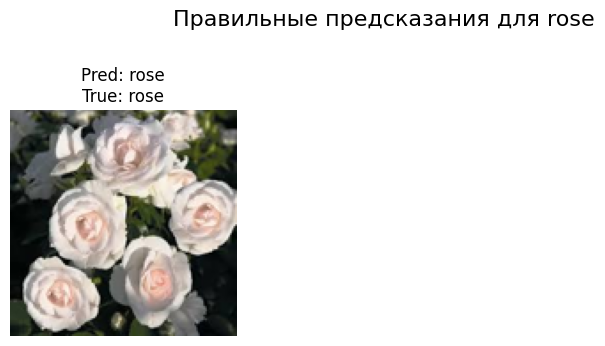

<Figure size 1000x1000 with 0 Axes>

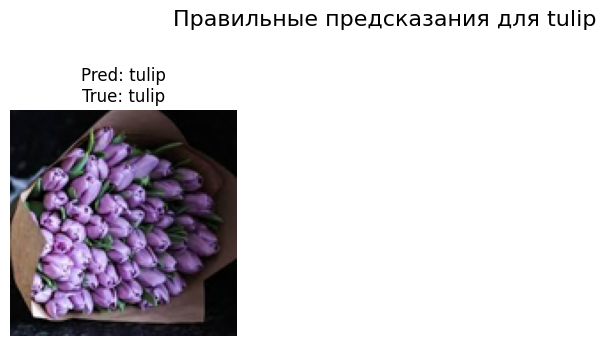

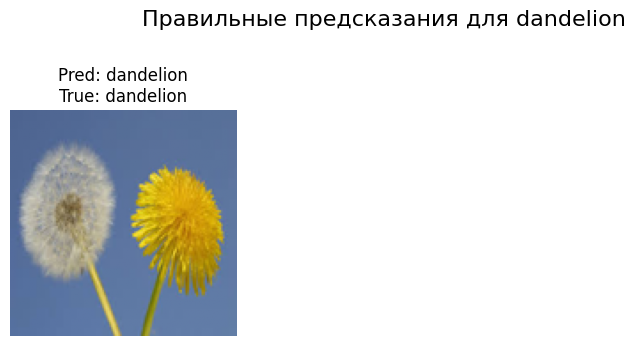

<Figure size 1000x1000 with 0 Axes>

Неправильные предсказания:


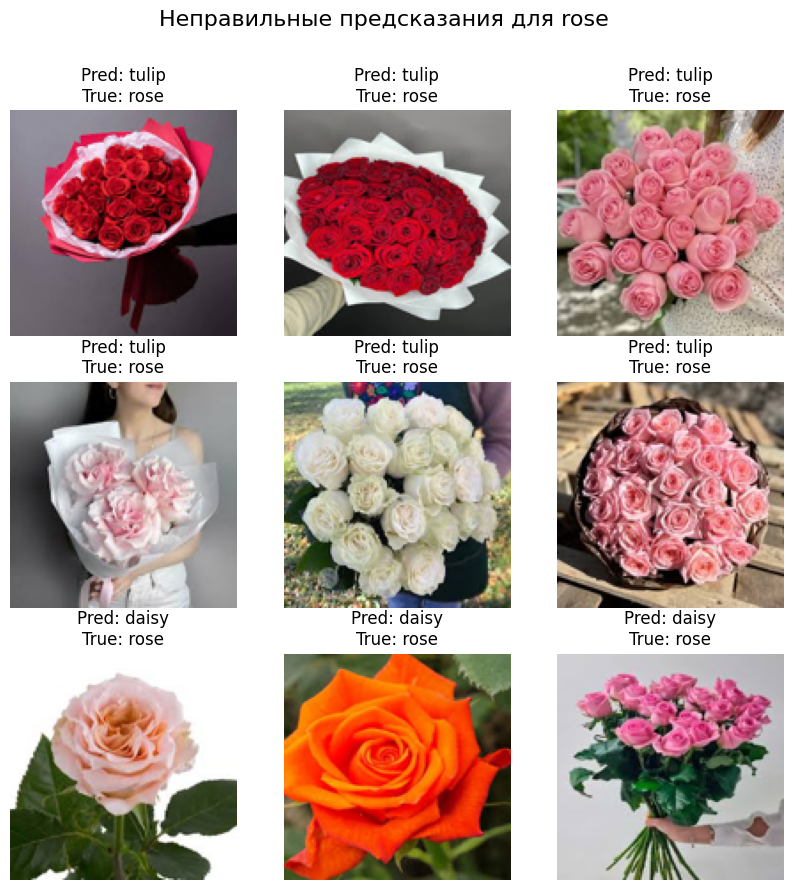

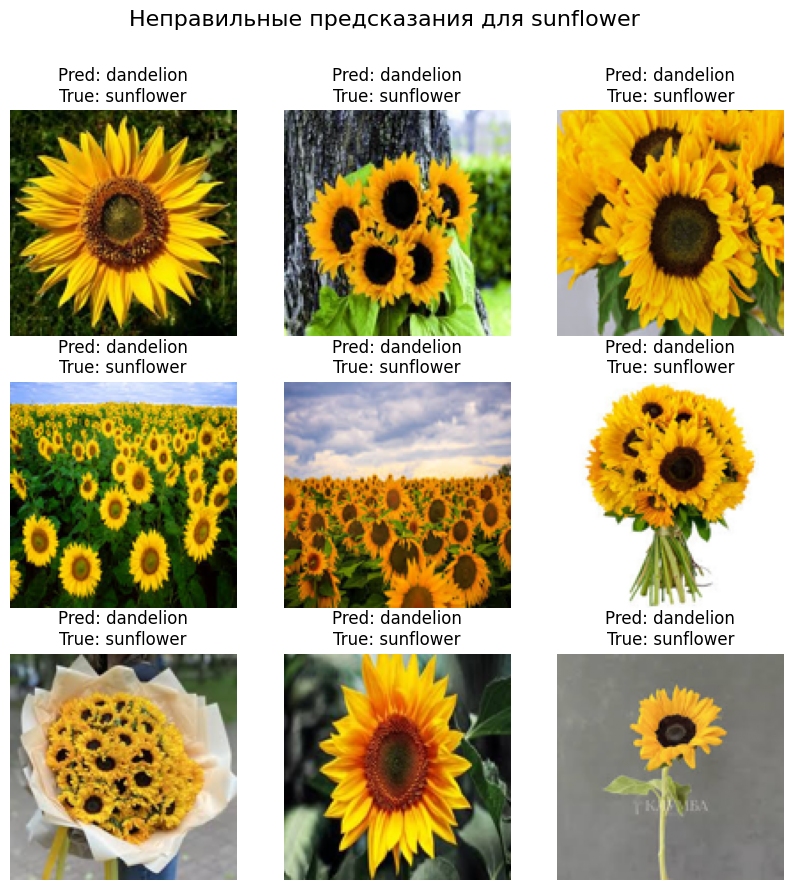

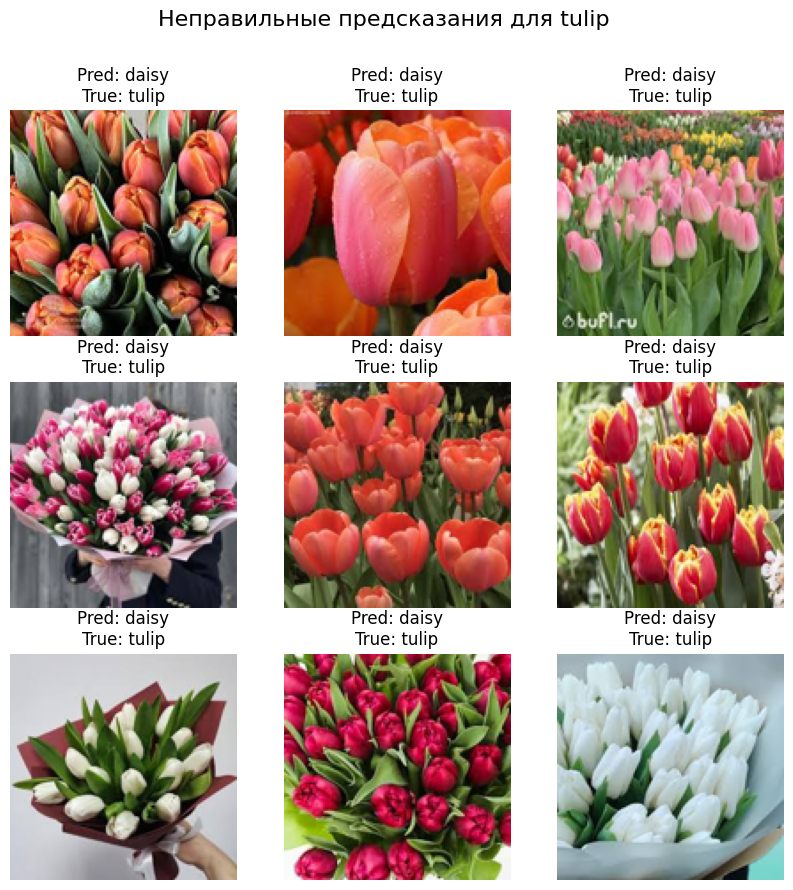

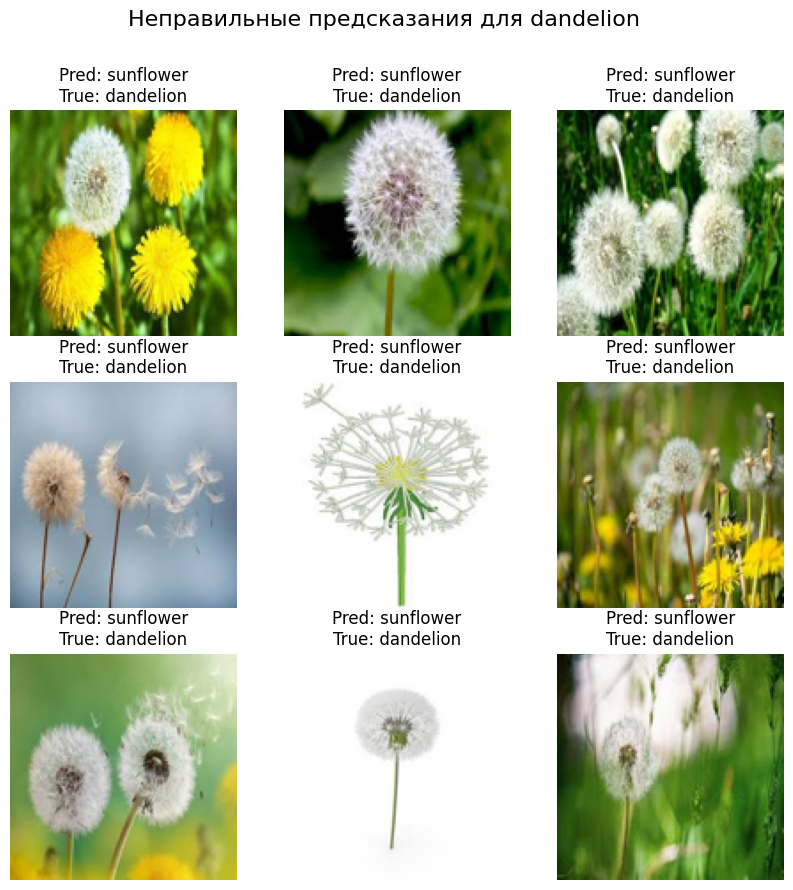

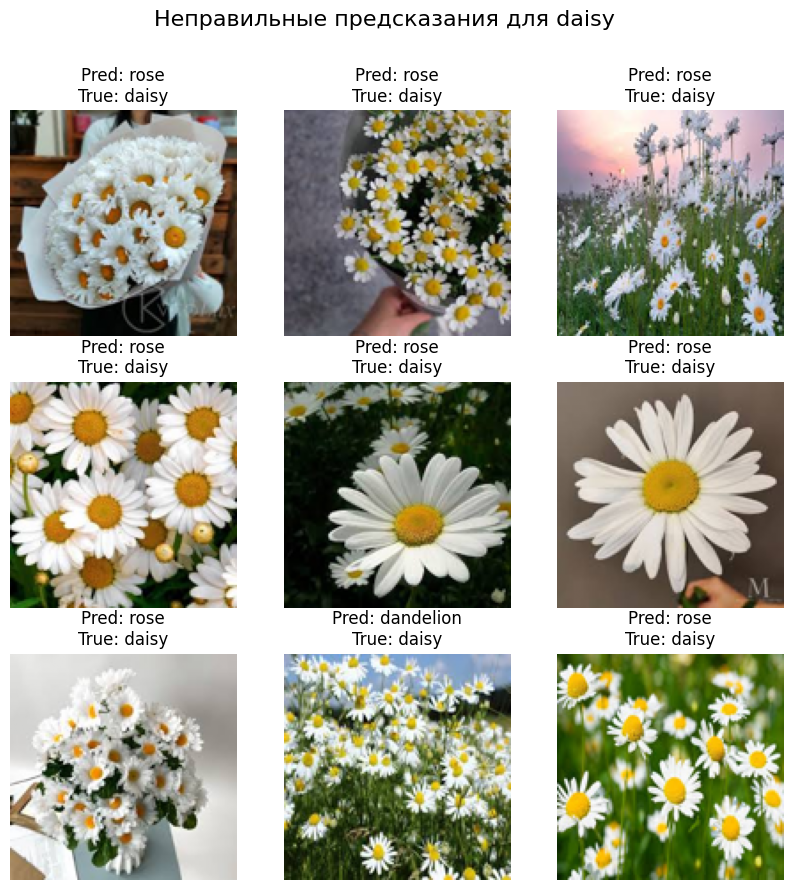

In [ ]:



correct_predictions = np.where(y_pred_cnn_augmented == y_test)[0]
incorrect_predictions = np.where(y_pred_cnn_augmented != y_test)[0]


print("Правильные предсказания:")
for label in np.unique(y_test):
    correct_label_indices = correct_predictions[y_test[correct_predictions] == label]
    display_images(correct_label_indices, f"Правильные предсказания для {categories[label]}", y_pred_cnn_augmented, y_test)


print("Неправильные предсказания:")
for label in np.unique(y_test):
    incorrect_label_indices = incorrect_predictions[y_test[incorrect_predictions] == label]
    display_images(incorrect_label_indices, f"Неправильные предсказания для {categories[label]}", y_pred_cnn_augmented, y_test)

In [ ]:
y_pred_cnn_augmented

array([2, 2, 2, 2, 2, 0, 2, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2,
       4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 3, 0, 0])

In [ ]:
file_id = '1SwmFR-CuFEQL3LV6rapZV7eu0_WlZOJM'
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('modelVGG16.h5')


model_vgg16 = load_model('modelVGG16.h5')

In [ ]:
y_pred_vgg16 = np.argmax(model_vgg16.predict(X_test), axis=1)

2/2 ━━━━━━━━━━━━━━━━━━━━ 12s 3s/step


Правильные предсказания:


<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

Неправильные предсказания:


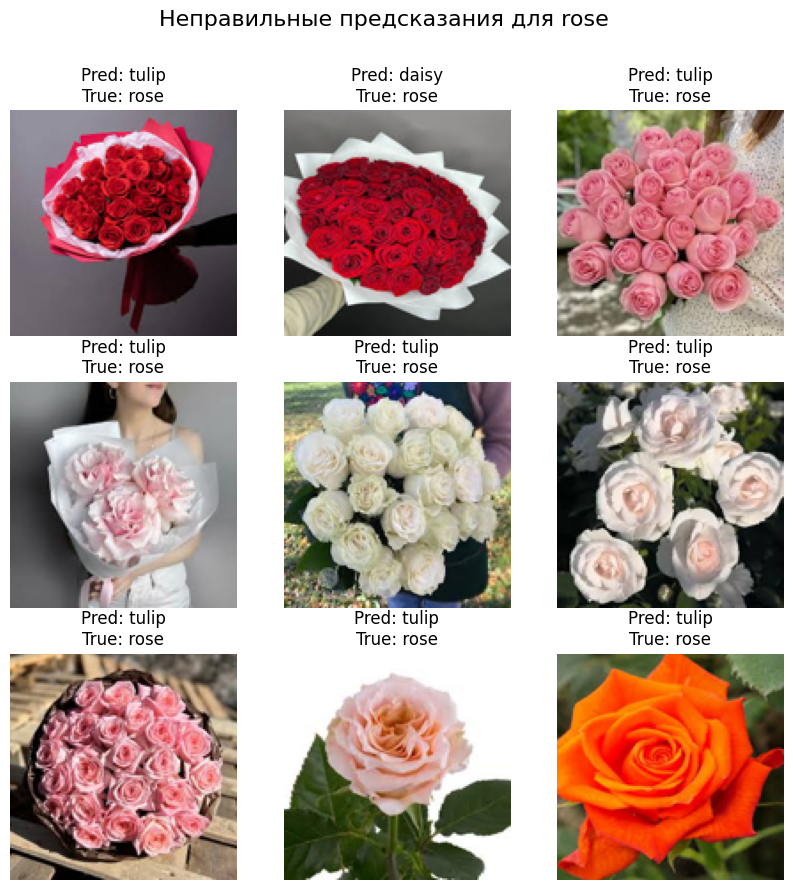

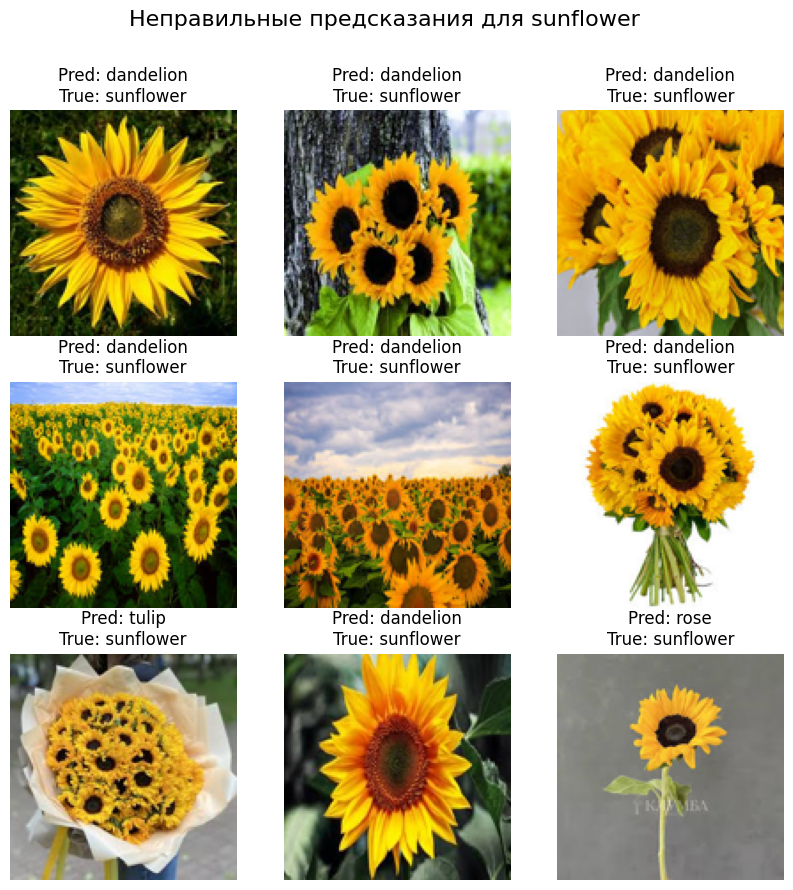

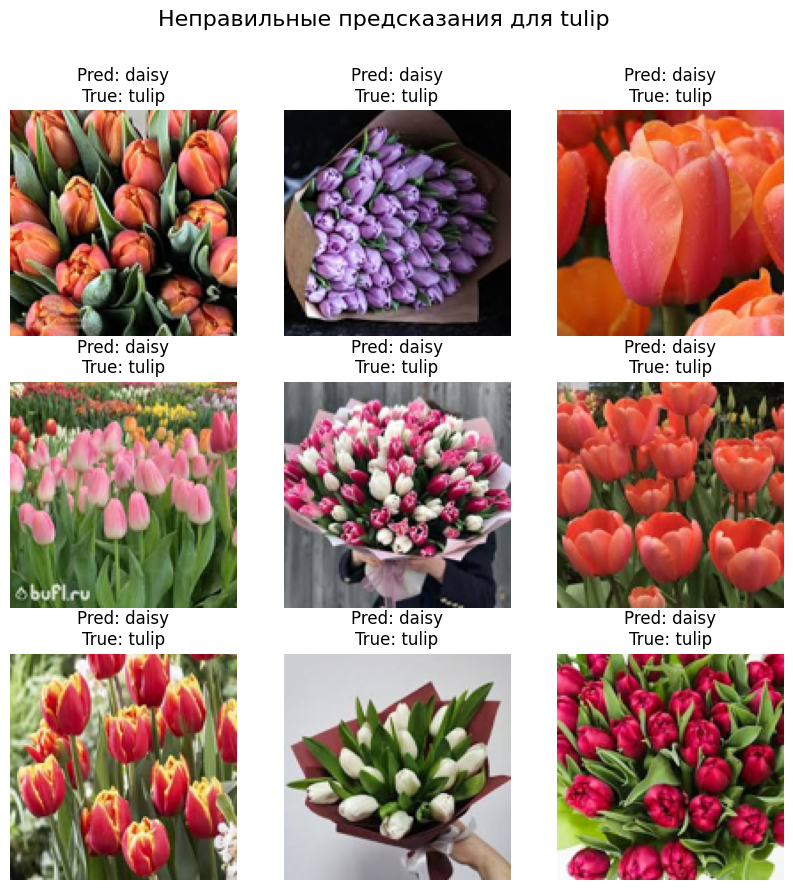

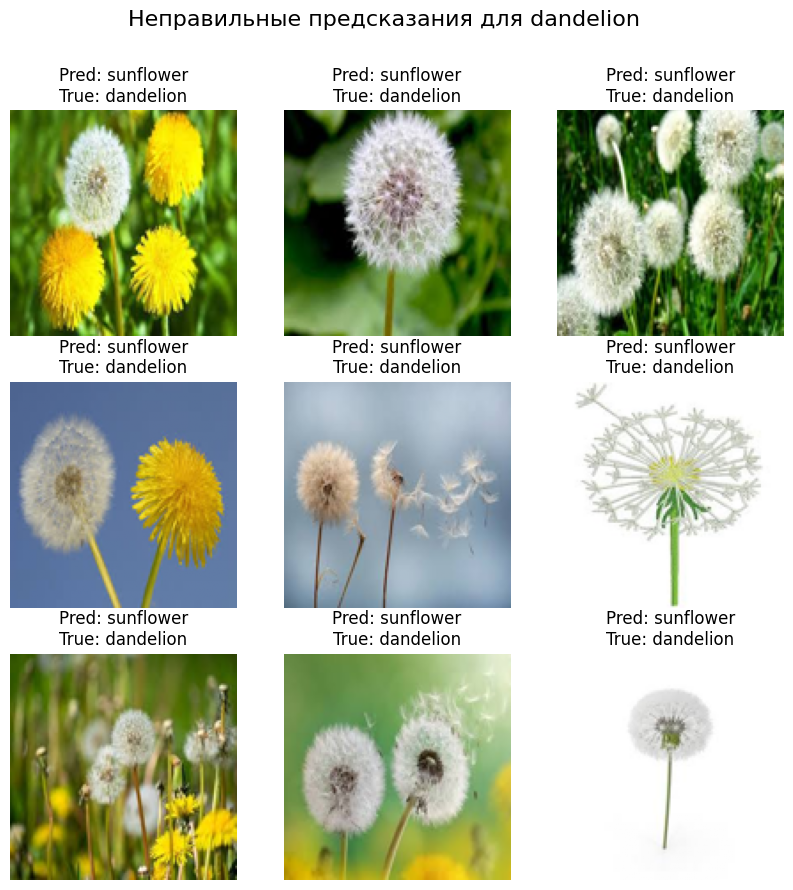

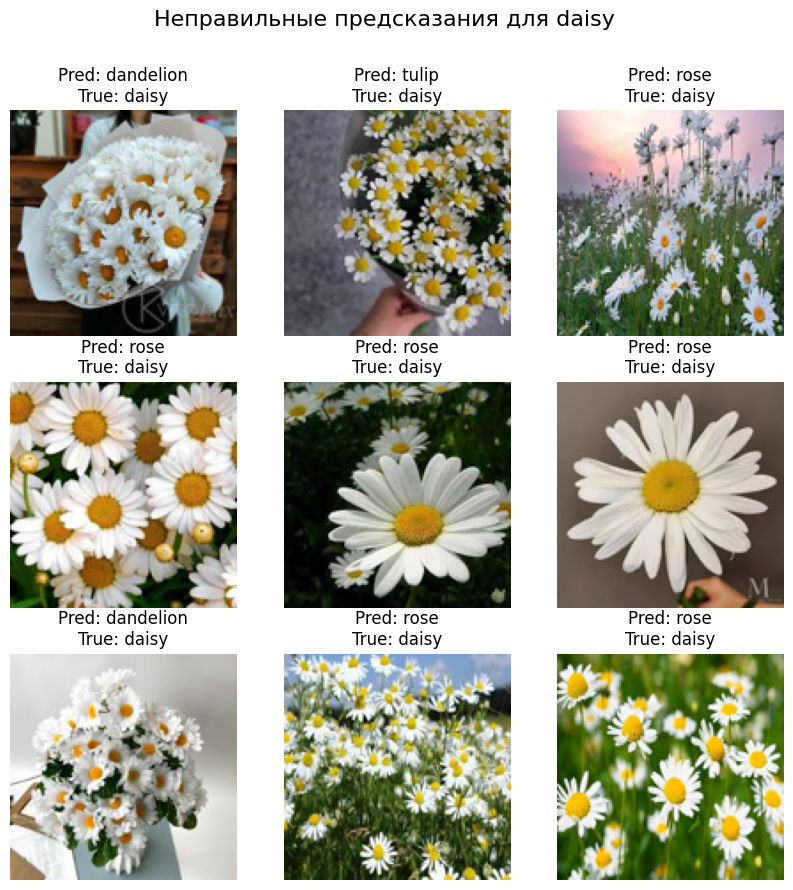

In [ ]:



correct_predictions = np.where(y_pred_vgg16 == y_test)[0]
incorrect_predictions = np.where(y_pred_vgg16 != y_test)[0]


print("Правильные предсказания:")
for label in np.unique(y_test):
    correct_label_indices = correct_predictions[y_test[correct_predictions] == label]
    display_images(correct_label_indices, f"Правильные предсказания для {categories[label]}", y_pred_vgg16, y_test)


print("Неправильные предсказания:")
for label in np.unique(y_test):
    incorrect_label_indices = incorrect_predictions[y_test[incorrect_predictions] == label]
    display_images(incorrect_label_indices, f"Неправильные предсказания для {categories[label]}", y_pred_vgg16, y_test)

In [ ]:
y_pred_vgg16

array([2, 4, 2, 2, 2, 2, 2, 2, 2, 4, 3, 3, 3, 3, 3, 3, 2, 3, 0, 3, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 0, 0,
       0, 0, 3, 0, 0, 0])